# Predicting Credit Worthiness

### Final project group 9: Furia Francesca, Illiano Anna, Seth Poorva

Sources:
- R. Turkson; E.Baagyere; G. Wenya (2009): The comparisons of data mining techniques for the predictive accuracy of probability of default of credit card clients 
- Yeh, I.-C., Lien, C.-H. (2016): A Machine Learning Approach for Predicting Bank Credit Worthiness


In [1]:
import numpy as np 
np.random.seed(0)
import pandas as pd 
#import matplotlib.pyplot as plt
import plotly.express as px

import sklearn
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler

# NON SERVE?
from sklearn.metrics import confusion_matrix

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

from sklearn.linear_model import LogisticRegression
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier

import sklearn.metrics as metrics

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier

In [2]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from scikeras.wrappers import KerasRegressor

from tensorflow import keras
from tensorflow.keras.layers import Activation
from tensorflow.keras import models

from collections import Counter

from tensorflow.random import set_seed
set_seed(0)
from tensorflow.keras.utils import set_random_seed
set_random_seed(0)

In [3]:
import utilities

# DATA IMPORT

for some data exploration, please refer to the notebook *group9_data_exploration.ipynb*.

In [4]:
data = pd.read_excel('default of credit card clients.xls', sheet_name='Data')
data.columns = data.iloc[0,:]
data.drop(index=0, inplace=True)
data.drop(columns='ID', inplace=True)
data = data.astype(int)
data

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
1,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
2,120000,2,2,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
3,90000,2,2,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
4,50000,2,2,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
5,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29996,220000,1,3,1,39,0,0,0,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29997,150000,1,3,2,43,-1,-1,-1,-1,0,...,8979,5190,0,1837,3526,8998,129,0,0,0
29998,30000,1,2,2,37,4,3,2,-1,0,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29999,80000,1,3,1,41,1,-1,0,0,0,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [5]:
# Defining response variable and input features
X = data.iloc[:,:-1]
y = data.iloc[:,-1]

# Splitting data with a 25/75% test train split
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify = y, random_state=5599, test_size=0.25)

In [6]:
X_train

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
14183,160000,1,2,2,29,0,0,0,0,0,...,115094,111678,105336,104306,5000,4000,5000,4000,3603,4200
6184,430000,2,2,2,27,-2,-2,-2,-2,-2,...,4119,4390,20952,15562,1764,4120,535,20990,2506,500
11370,10000,1,2,2,23,0,0,-1,-1,0,...,1651,9984,10096,9847,1033,1651,9984,415,358,114
23952,50000,1,2,2,24,0,0,0,-1,0,...,3957,52522,31921,29265,2064,1053,53874,1009,934,719
504,130000,2,1,1,33,0,0,0,0,0,...,22704,22304,22304,0,2000,3000,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12352,250000,2,1,1,32,0,0,0,0,0,...,240332,244688,240221,224740,10500,12000,10000,10000,9000,9000
8712,100000,2,2,2,24,-1,-1,-1,-1,-1,...,1967,5476,396,811,0,1967,7142,396,811,817
22081,100000,2,2,2,28,2,0,0,2,2,...,26789,26065,27615,28122,1400,5000,0,2300,1100,1300
9665,20000,1,2,2,23,0,0,2,0,0,...,19621,14051,0,0,4183,0,281,0,0,0


In [7]:
ss= StandardScaler()

X_train = ss.fit_transform(X_train)
X_test = ss.transform(X_test)

# PREPARATION FOR VARIABLE SELECTION APPLICATIONS

Below is a list of variables we are choosing to keep for the purposes of re-running our models on the selected variables:
- LIMIT_BAL
- EDUCATION
- SEX
- PUNCTUALITY_AVG (Avg of PAY_0, PAY_2, etc.)

(see notebook *group9_feature_selection.ipynb*)

In [8]:
data['PUNCTUALITY_AVG'] = data[['PAY_0', 'PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']].mean(axis=1)

In [9]:
X_vs = data[['LIMIT_BAL', 'SEX', 'EDUCATION', 'PUNCTUALITY_AVG']]
y_vs = data['default payment next month']

X_train_vs, X_test_vs, y_train_vs, y_test_vs = train_test_split(X_vs, y_vs, stratify = y_vs, random_state=5599)

In [10]:
ss2= StandardScaler()

X_train_vs = ss2.fit_transform(X_train_vs)
X_test_vs = ss2.transform(X_test_vs)

We define a helper function to save the scores for each model and make a final comparison.

In [263]:
def save_scores(macro_recall, accuracy, r2, auc, method_name):
    method_names.append(method_name)
    macro_recalls.append(macro_recall)
    accuracies.append(accuracy)
    r2s.append(r2)
    aucs.append(auc)
    
method_names, macro_recalls, accuracies, r2s, aucs = [],[],[],[],[]

# Methods

The methods implemented in this section are:
1. QDA
2. KNN
3. Logistic Regression
4. Bagging
5. Neural Networks
6. Gaussian Naive Bayes Classifier

For every method, we will propose an analysis on the whole dataset, and then repeat the same process using only the 5 most significant features obtained with variable selection (see notebook *group9_feature_selection.ipynb*). 

## Evaluation Strategies

### 1. Recall 

We specifically care about keeping false negatives low, as it’s worse to lend money to people who will actually default, rather than the other way around.
Hence we primarily use **recall** to assess our methods, as it measures the ability of the classifier to find all the positive samples. 
We use the **macro-averaged recall** in order to avoid overfitting on the defaulting class, since we also want to avoid having models that predict all samples as defaulting.

### 2. Sorting Smoothing Method

The goal is to estimate the “true” probability of default, which is obtained by:

1. ordering the predictions by increasing estimated probability of default


2. for each instance, estimate the “true” probability of defaulting by computing the percentage of defaulting samples among the n observations above and below in the ordered list of predictions


3. in order to explore whether the predicted probability of default from our model actually represents the “real” probability of default, we:
    - Scatterplot estimated probability VS real probability
    - Run a OLS and look at R-squared, intercept and slope coefficient





## Quadratic Discriminant Analysis

In [186]:
estimator_3 = QuadraticDiscriminantAnalysis()
parameters_3 = {
    'reg_param': (1e-4, 1e-3, 1e-2, 1e-1, 0.25, 0.35, 0.40, 0.43, 0.45, 0.47, 0.50, 0.55, 0.60, 0.70), 
    'store_covariance': (True, False),
    'tol': (0.0001, 0.001,0.01, 0.1, 1), 
                   }
# with GridSearch
grid_search_qda = GridSearchCV(
    estimator=estimator_3,
    param_grid=parameters_3,
    scoring = 'recall_macro',
    n_jobs = -1,
    cv = 5
)
QDA = grid_search_qda.fit(X_train, y_train)

In [187]:
QDA = QDA.best_estimator_
QDA

QuadraticDiscriminantAnalysis(reg_param=0.45, store_covariance=True)

In [188]:
preds_QDA =QDA.predict(X_test)

In [189]:
utilities.plot_cm(y_test, preds_QDA)

In [190]:
print(classification_report(y_test, preds_QDA))

              precision    recall  f1-score   support

           0       0.88      0.84      0.86      5841
           1       0.51      0.59      0.55      1659

    accuracy                           0.78      7500
   macro avg       0.70      0.71      0.70      7500
weighted avg       0.80      0.78      0.79      7500



In [191]:
pred_probs = QDA.predict_proba(X_test)
pred_labels =QDA.predict(X_test)

In [192]:
df_pred, summary_QDA = utilities.compute_SSM(pred_probs, pred_labels, true_labels=y_test, name_model='QDA')

In [193]:
summary_QDA

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.859
Model:                            OLS   Adj. R-squared:                  0.859
Method:                 Least Squares   F-statistic:                 4.505e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:38:49   Log-Likelihood:                 9232.7
No. Observations:                7400   AIC:                        -1.846e+04
Df Residuals:                    7398   BIC:                        -1.845e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0377      0.001    -26.099      0.000      -0.041      -0.035
x1             0.6578      0.003    212.260      0.000       0.652       0.664
==============================================================================
Omnibus:                      393.492   Durbin-Watson:                   0.006
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              312.762
Skew:                           0.419   Prob(JB):                     1.22e-68
Kurtosis:                       2.441   Cond. No.                         4.44
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [194]:
utilities.plot_ROC(pred_probs, y_test, model_name='QDA')

In [195]:
utilities.plot_SSM(df_pred)

In this case, the accuracy of the model is quite good, as well as the R-squared obtained from the regression of default probabilites. 

In this case, we plot a chart representing the *Distribution of prediction according to the SSM method* to visually explain this. This graph shows how the proportion of defaulting samples in each decile is increasing, and each decile is a proportion of a list of samples ordered according to the predicted probability of default. This is intended to show graphically that the true probability of default increases with the predicted one, thus showing that the SSM methos is quite useful.

The performance on the defaulting class is also quite good, as can be seen in the confusion matrix which shows that most samples in this class are correctly classified. The value of 71% of the macro recall is also quite good.

In [264]:
save_scores(macro_recall=0.71, accuracy=0.78, r2=0.859, auc=0.7546, method_name='QDA')

### QDA with variable selection

In [23]:
estimator_3 = QuadraticDiscriminantAnalysis()
parameters_3 = {
    'reg_param': (1e-4, 1e-3, 1e-2, 1e-1, 0.25, 0.35, 0.40, 0.43, 0.45, 0.47, 0.50, 0.55, 0.60, 0.70), 
    'store_covariance': (True, False),
    'tol': (0.0001, 0.001,0.01, 0.1, 1), 
                   }
# with GridSearch
grid_search_qda = GridSearchCV(
    estimator=estimator_3,
    param_grid=parameters_3,
    scoring = 'recall_macro',
    n_jobs = -1,
    cv = 5
)
QDA = grid_search_qda.fit(X_train_vs, y_train_vs)

In [24]:
QDA = QDA.best_estimator_
QDA

QuadraticDiscriminantAnalysis(reg_param=0.0001, store_covariance=True)

In [25]:
preds_QDA_vs =QDA.predict(X_test_vs)

In [26]:
utilities.plot_cm(y_test_vs, preds_QDA_vs)

In [27]:
print(classification_report(y_test_vs, preds_QDA_vs))

              precision    recall  f1-score   support

           0       0.81      0.97      0.88      5841
           1       0.67      0.21      0.32      1659

    accuracy                           0.80      7500
   macro avg       0.74      0.59      0.60      7500
weighted avg       0.78      0.80      0.76      7500



In this case, it is apparent from the confusion matrix how the performance on defaulting samples is poorer compared to before.

In [28]:
pred_probs_vs = QDA.predict_proba(X_test_vs)
pred_labels_vs =QDA.predict(X_test_vs)

In [29]:
df_pred_vs, summary_QDA_vs = utilities.compute_SSM(pred_probs_vs, pred_labels_vs, true_labels=y_test_vs, name_model='QDA with variable selection')

In [30]:
summary_QDA_vs

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.812
Model:                            OLS   Adj. R-squared:                  0.812
Method:                 Least Squares   F-statistic:                 3.204e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:05:34   Log-Likelihood:                 9135.3
No. Observations:                7400   AIC:                        -1.827e+04
Df Residuals:                    7398   BIC:                        -1.825e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0178      0.001     12.882      0.000       0.015       0.020
x1             0.9140      0.005    179.009      0.000       0.904       0.924
==============================================================================
Omnibus:                      909.001   Durbin-Watson:                   0.014
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1425.614
Skew:                           0.874   Prob(JB):                    2.70e-310
Kurtosis:                       4.253   Cond. No.                         6.54
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [31]:
utilities.plot_ROC(pred_probs_vs, y_test_vs, model_name='QDA with variable selection')

The overall accuracy of the model has slightly increased, however the R-squared of the predicted probabilities regression has decreases. This indicates that the model performs worse than before, albeit slightly, which is quite good for a model built on such a small number of features.

In [265]:
save_scores(macro_recall=0.59, accuracy=0.80, r2=0.812, auc=0.7079, method_name='QDA with variable selection')

## K-Nearest Neighbours Classifier

Now, we will do a K Nereast Neighbours Classifier using all thw variables as input.
In particular, we will implement this method with oversampling to improve its performance on the defaulting class.

In [34]:
from imblearn.over_sampling import RandomOverSampler
over_sampler = RandomOverSampler(random_state=42)
X_res, y_res = over_sampler.fit_resample(X_train, y_train)
print(f"Training target statistics: {Counter(y_res)}")
print(f"Testing target statistics: {Counter(y_test)}")

Training target statistics: Counter({0: 17523, 1: 17523})
Testing target statistics: Counter({0: 5841, 1: 1659})


In [35]:
# Performaing grid search in order to find the best number of neighbours.

grid_params = {
    'n_neighbors' : [51, 55, 61, 65, 71, 75, ],
    #'weights': ['uniform','distance'], 'metric': ['euclidean', 'manhattan']
}

grid_search = GridSearchCV(
    KNeighborsClassifier(weights='distance', metric='euclidean'),
    grid_params,
    scoring='recall_macro', #recall
    verbose=2,
    #refit='recall',
    cv=5,
    n_jobs=-1
)

gs_results = grid_search.fit(X_res, y_res)

Fitting 5 folds for each of 6 candidates, totalling 30 fits


In [36]:
best_KNN = gs_results.best_estimator_
best_KNN

KNeighborsClassifier(metric='euclidean', n_neighbors=75, weights='distance')

In [37]:
preds = best_KNN.predict(X_test)
preds.sum()

2364

In [38]:
pred_probs = best_KNN.predict_proba(X_test)

In [39]:
utilities.plot_cm(y_test, preds)

In [40]:
print(classification_report(y_test, preds)) #51

              precision    recall  f1-score   support

           0       0.88      0.77      0.82      5841
           1       0.44      0.63      0.52      1659

    accuracy                           0.74      7500
   macro avg       0.66      0.70      0.67      7500
weighted avg       0.78      0.74      0.76      7500



This second method also shows a good performance on the defaulting samples, since it is again able to predict most of them.

In [41]:
df_pred, summary_KNN = utilities.compute_SSM(pred_probs, preds, y_test, name_model='KNN')

In [42]:
summary_KNN

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.848
Model:                            OLS   Adj. R-squared:                  0.848
Method:                 Least Squares   F-statistic:                 4.137e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:06:05   Log-Likelihood:                 9163.3
No. Observations:                7400   AIC:                        -1.832e+04
Df Residuals:                    7398   BIC:                        -1.831e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1132      0.002    -62.404      0.000      -0.117      -0.110
x1             0.7697      0.004    203.397      0.000       0.762       0.777
==============================================================================
Omnibus:                      245.238   Durbin-Watson:                   0.005
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              246.933
Skew:                           0.417   Prob(JB):                     2.39e-54
Kurtosis:                       2.673   Cond. No.                         5.53
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [43]:
utilities.plot_ROC(pred_probs, y_test, model_name='KNN')

Overall, the KNN classifier has an adequate performance, both considering the macro-recall and the R-squared of the regression. 

In [266]:
save_scores(macro_recall=0.70, accuracy=0.74, r2=0.848, auc=0.7579, method_name='KNN')

### KNN with Variable Selection


In [46]:
from imblearn.over_sampling import RandomOverSampler
over_sampler = RandomOverSampler(random_state=42)
X_res_vs, y_res_vs = over_sampler.fit_resample(X_train_vs, y_train_vs)
print(f"Training target statistics: {Counter(y_res_vs)}")
print(f"Testing target statistics: {Counter(y_test_vs)}")

Training target statistics: Counter({0: 17523, 1: 17523})
Testing target statistics: Counter({0: 5841, 1: 1659})


In [47]:
# Performaing grid search in order to find the best number of neighbours.
grid_params = {
    'n_neighbors' : [51, 55, 61, 65, 71, 75, ],
    #'weights': ['uniform','distance'], 'metric': ['euclidean', 'manhattan']
}

grid_search = GridSearchCV(
    KNeighborsClassifier(weights='distance', metric='euclidean'),
    grid_params,
    scoring='recall_macro', #recall
    verbose=2,
    #refit='recall',
    cv=5,
    n_jobs=-1
)

gs_results = grid_search.fit(X_res_vs, y_res_vs)

Fitting 5 folds for each of 6 candidates, totalling 30 fits


In [48]:
best_KNN = gs_results.best_estimator_
best_KNN

KNeighborsClassifier(metric='euclidean', n_neighbors=75, weights='distance')

In [49]:
preds = best_KNN.predict(X_test_vs)
preds.sum()

2281

In [50]:
pred_probs = best_KNN.predict_proba(X_test_vs)

In [51]:
utilities.plot_cm(y_test_vs, preds)

In [52]:
print(classification_report(y_test_vs, preds)) #51

              precision    recall  f1-score   support

           0       0.86      0.77      0.81      5841
           1       0.40      0.55      0.46      1659

    accuracy                           0.72      7500
   macro avg       0.63      0.66      0.64      7500
weighted avg       0.76      0.72      0.73      7500



In [53]:
df_pred, summary_KNN = utilities.compute_SSM(pred_probs, preds, y_test_vs, name_model='KNN with variable selection')

In [54]:
summary_KNN

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.676
Model:                            OLS   Adj. R-squared:                  0.676
Method:                 Least Squares   F-statistic:                 1.544e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:06:14   Log-Likelihood:                 8105.9
No. Observations:                7400   AIC:                        -1.621e+04
Df Residuals:                    7398   BIC:                        -1.619e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0746      0.001     50.126      0.000       0.072       0.078
x1             0.3958      0.003    124.255      0.000       0.390       0.402
==============================================================================
Omnibus:                      337.583   Durbin-Watson:                   0.025
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              384.860
Skew:                           0.557   Prob(JB):                     2.68e-84
Kurtosis:                       2.928   Cond. No.                         3.87
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [55]:
utilities.plot_ROC(pred_probs, y_test_vs, model_name='KNN')

The model implemented with feature selection has a lower performance on all the metrics evaluated. This decline is however quite small.

In [267]:
save_scores(macro_recall=0.66, accuracy=0.72, r2=0.676, auc=0.6788, method_name='KNN with variable selection')

## Logistic Regression

We will perform a basic logistic regression, beginning by using all variables.

In [58]:
logreg = LogisticRegression(max_iter=1000, random_state=5599)
logreg.fit(X_train, np.ravel(y_train))

LogisticRegression(max_iter=1000, random_state=5599)

In [59]:
#Obtaining accuracy of logistic regression
y_pred = logreg.predict(X_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(X_test, y_test)))

Accuracy of logistic regression classifier on test set: 0.81


In [60]:
utilities.plot_cm(y_test,y_pred)

In [61]:
# Printing classification report of our unbalanced model.
print(metrics.classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.82      0.98      0.89      5841
           1       0.73      0.23      0.35      1659

    accuracy                           0.81      7500
   macro avg       0.77      0.60      0.62      7500
weighted avg       0.80      0.81      0.77      7500



Above is the classification report for unbalanced, which is not working out well as it is predicting almost everything as 0 (extremely high recall for class 0, i.e. non defaulting). We can also see in the confusion matrix that the percentage of true positives is too low for our purposes.

Therefore, we will try logistic regression again, but this time adding a parameter which can account for the class imbalance in our dataset.

In [62]:
# Trying logistic regression again, but using the parameter class weight = balanced.

logreg2 = LogisticRegression(class_weight='balanced',max_iter=1000, random_state=5599)
logreg2.fit(X_train, np.ravel(y_train))

LogisticRegression(class_weight='balanced', max_iter=1000, random_state=5599)

In [63]:
#Obtaining accuracy of logistic regression after balancing weights

y_pred_2 = logreg2.predict(X_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg2.score(X_test, y_test)))

Accuracy of logistic regression classifier on test set: 0.69


In [64]:
# Printing classification report of our balanced model.

print(classification_report(y_test, y_pred_2)) #balanced

              precision    recall  f1-score   support

           0       0.88      0.70      0.78      5841
           1       0.39      0.66      0.49      1659

    accuracy                           0.69      7500
   macro avg       0.63      0.68      0.64      7500
weighted avg       0.77      0.69      0.72      7500



Above, we see a lower accuracy compared to the unbalanced model, but a higher macro average recall which is what we care about for our purposes, so we choose this and continue with it.

In [65]:
utilities.plot_cm(y_test,y_pred_2)

Here, we have printed our confusion matrix. This looks fairly good since we want false negatives to be low and penalized harder than false positives.

In [66]:
# Obtaining our prediction probabilities of predicting each outcome for each observation.

y_pred_prob_2 = logreg2.predict_proba(X_test)
#y_pred_prob_2

In [67]:
#Comparing predicted probabilities from our model, with the estimated true probability of default.
ordered, OLS_summary = utilities.compute_SSM(y_pred_prob_2, y_pred_2, y_test,logreg2)

In [68]:
OLS_summary

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.684
Model:                            OLS   Adj. R-squared:                  0.684
Method:                 Least Squares   F-statistic:                 1.604e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:06:18   Log-Likelihood:                 6272.9
No. Observations:                7400   AIC:                        -1.254e+04
Df Residuals:                    7398   BIC:                        -1.253e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.2046      0.004    -57.818      0.000      -0.211      -0.198
x1             0.9170      0.007    126.663      0.000       0.903       0.931
==============================================================================
Omnibus:                     1352.112   Durbin-Watson:                   0.003
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              504.370
Skew:                           0.443   Prob(JB):                    3.00e-110
Kurtosis:                       2.077   Cond. No.                         7.30
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [69]:
# We also plot the ROC curve and obtain a measure for area under the curve.

utilities.plot_ROC(y_pred_prob_2, y_test, model_name='Logistic Regression')

In [268]:
save_scores(macro_recall=0.68, accuracy=0.69, r2=0.684, auc=0.7391, method_name='Logistic Regression')

### Logistic Regression with Variable Selection

Now, we do everything we did above, but only using the inputs which were chosen in our variable selection, still doing a balanced logistic regression.


In [71]:
logreg2_VS = LogisticRegression(class_weight='balanced',max_iter=1000, random_state=5599)
logreg2_VS.fit(X_train_vs, np.ravel(y_train_vs))

LogisticRegression(class_weight='balanced', max_iter=1000, random_state=5599)

In [72]:
y_pred_2_VS = logreg2_VS.predict(X_test_vs)
print('Accuracy of logistic regression classifier on test set with variable selection: {:.2f}'.format(logreg2_VS.score(X_test_vs, y_test_vs)))

Accuracy of logistic regression classifier on test set with variable selection: 0.63


In [73]:
utilities.plot_cm(y_test_vs,y_pred_2_VS)

In [74]:
print(classification_report(y_test_vs, y_pred_2_VS))

              precision    recall  f1-score   support

           0       0.87      0.62      0.72      5841
           1       0.33      0.66      0.44      1659

    accuracy                           0.63      7500
   macro avg       0.60      0.64      0.58      7500
weighted avg       0.75      0.63      0.66      7500



In [75]:
y_pred_prob_2_VS = logreg2_VS.predict_proba(X_test_vs)
#y_pred_prob_2_VS

In [76]:
#Comparing predicted probabilities from our model, with the estimated true probability of default.
ordered2, OLS_summary2 = utilities.compute_SSM(y_pred_prob_2_VS, y_pred_2_VS, y_test_vs,logreg2_VS)

In [77]:
OLS_summary2

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.551
Model:                            OLS   Adj. R-squared:                  0.551
Method:                 Least Squares   F-statistic:                     9081.
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:06:24   Log-Likelihood:                 5769.4
No. Observations:                7400   AIC:                        -1.153e+04
Df Residuals:                    7398   BIC:                        -1.152e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.2141      0.005    -45.554      0.000      -0.223      -0.205
x1             0.9112      0.010     95.293      0.000       0.892       0.930
==============================================================================
Omnibus:                     1034.186   Durbin-Watson:                   0.006
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              479.794
Skew:                           0.456   Prob(JB):                    6.52e-105
Kurtosis:                       2.148   Cond. No.                         9.09
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [78]:
# We also plot the ROC curve and obtain a measure for area under the curve.
utilities.plot_ROC(y_pred_prob_2_VS, y_test, model_name='Logistic Regression w/ var.sel.')

In [269]:
save_scores(macro_recall=0.64, accuracy=0.63, r2=0.551, auc=0.7009, method_name='Logistic Regression with variable selection')

## BAGGING

Next, we attempt to use bootstrap aggregating for our model, first on all the variables, and secondly using the subset selected with variables selection.

In [196]:
# Perform grid search to optimize number of estimators, and depth of trees
estimator_range = [2,4,6,8,10,12,14,16,18]
depth_range=[5,10, 15, 50, 100, None]

In [197]:
#Create dataframe to store results of grid search
scores = pd.DataFrame(columns=['n_estimators','depth','score'],index=np.arange(len(estimator_range)*len(depth_range)))
i=0
for n_estimators in estimator_range:
    for depth in depth_range:
        # Create bagging classifier
        clf = BaggingClassifier(DecisionTreeClassifier(max_depth=depth,
                                                        random_state=5599,
                                                        criterion='entropy'
                                                        ), n_estimators = n_estimators, random_state = 5599)
        clf.fit(X_train, y_train) # Fit the model
        
        # Append the model and their recall score to the dataframe and show it.
        scores.iloc[i,:]=[n_estimators, depth, metrics.recall_score(y_true = y_test, y_pred = clf.predict(X_test))]
        i+=1

In [198]:
# Here, we can see that 2 estimators with 10 depth is optimal
scores.sort_values('score', ascending=False).head()

,n_estimators,depth,score
1,2,10,0.3695
7,4,10,0.368897
13,6,10,0.366486
19,8,10,0.365883
0,2,5,0.364075


In [199]:
# Define bagging classifier with the parameters we optimized above
bagging = BaggingClassifier(DecisionTreeClassifier(max_depth=10,
                                                        random_state=5599,
                                                        criterion='entropy'
                                                        ), n_estimators = 2, random_state = 5599)

In [200]:
bagging.fit(X_train, y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(criterion='entropy',
                                                        max_depth=10,
                                                        random_state=5599),
                  n_estimators=2, random_state=5599)

In [201]:
pred_labels = bagging.predict(X_test)
pred_probs= bagging.predict_proba(X_test)

In [202]:
utilities.plot_cm(y_test,pred_labels)

In [203]:
print(classification_report(y_test, pred_labels))

              precision    recall  f1-score   support

           0       0.84      0.94      0.89      5841
           1       0.63      0.37      0.47      1659

    accuracy                           0.81      7500
   macro avg       0.73      0.65      0.68      7500
weighted avg       0.79      0.81      0.79      7500



The confusion matrix suggests a poor performance on the predictions of the defaulting set, which is supported by the moderate value of macro recall.

In [204]:
# Use SSM to obtain 'true' probability of default and compare it to our model
df_pred, OLS_summary = utilities.compute_SSM(pred_probs, pred_labels, true_labels=y_test, name_model=bagging, n=50)

In [205]:
OLS_summary

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.931
Model:                            OLS   Adj. R-squared:                  0.931
Method:                 Least Squares   F-statistic:                 1.004e+05
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:55:53   Log-Likelihood:                 11977.
No. Observations:                7400   AIC:                        -2.395e+04
Df Residuals:                    7398   BIC:                        -2.394e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0375      0.001     47.297      0.000       0.036       0.039
x1             0.8140      0.003    316.827      0.000       0.809       0.819
==============================================================================
Omnibus:                      490.189   Durbin-Watson:                   0.069
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              613.194
Skew:                           0.631   Prob(JB):                    7.02e-134
Kurtosis:                       3.629   Cond. No.                         4.84
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [206]:
utilities.plot_ROC(pred_probs, y_test, model_name='Bagging')

With bagging of decision tree classifiers, we see that we obtain a very good performance in terms of predicted probabilities of default. The regression of "true" versus predicted shows in fact a high R-squared and very good values for the intercept and slope, thus suggesting that the predicted probability is a very good proxy for the real one. 

Below, we plot the *Distribution of prediction according to the SSM method* to further give evidence to this claim.

In [207]:
utilities.plot_SSM(df_pred)

In [270]:
save_scores(macro_recall=0.65, accuracy=0.81, r2=0.931, auc=0.7559, method_name='Bagging')

## Bagging with Variable Selection

Now, we will do the same analysis as above but only using the selected variables as input that we obtained from variable selection. We will use grid searching again using the same parameters as above.

In [92]:
#. Grid search and bagging classifier on selected variables
scores2 = pd.DataFrame(columns=['n_estimators','depth','score'], index=np.arange(len(estimator_range)*len(depth_range)))
i=0
for n_estimators in estimator_range:
    for depth in depth_range:
        # Create bagging classifier
        clf = BaggingClassifier(DecisionTreeClassifier(max_depth=depth,
                                                        random_state=5599,
                                                        criterion='entropy'
                                                        ), n_estimators = n_estimators, random_state = 5599)
        # Fit the model
        clf.fit(X_train_vs, y_train_vs)

        # Append the model and recall score to their respective list
        scores2.iloc[i,:]=[n_estimators, depth, metrics.recall_score(y_true = y_test_vs, y_pred = clf.predict(X_test_vs))]
        i+=1

In [93]:
scores2.sort_values('score', ascending=False).head()

,n_estimators,depth,score
6,4,5,0.307414
18,8,5,0.306811
36,14,5,0.306811
42,16,5,0.306209
12,6,5,0.306209


In [94]:
# Perform bagging classifier with the newfound best parameters
bagging2 = BaggingClassifier(DecisionTreeClassifier(max_depth=5,
                                                        random_state=5599,
                                                        criterion='entropy'
                                                        ), n_estimators = 4, random_state = 5599)

In [95]:
# Fit our bagging classifier onto the variable selected data

bagging2.fit(X_train_vs, y_train_vs)

BaggingClassifier(base_estimator=DecisionTreeClassifier(criterion='entropy',
                                                        max_depth=5,
                                                        random_state=5599),
                  n_estimators=4, random_state=5599)

In [96]:
pred_labels2 = bagging2.predict(X_test_vs)
pred_probs_2= bagging2.predict_proba(X_test_vs)

In [97]:
# Confusion matrix 
utilities.plot_cm(y_test_vs,pred_labels2)

In [98]:
print(classification_report(y_test_vs, pred_labels2))

              precision    recall  f1-score   support

           0       0.83      0.95      0.88      5841
           1       0.63      0.31      0.41      1659

    accuracy                           0.81      7500
   macro avg       0.73      0.63      0.65      7500
weighted avg       0.79      0.81      0.78      7500



In [99]:
# Use SSM method to get 'true' probability of default and compare with our model
df_pred2, OLS2_summary = utilities.compute_SSM(pred_probs_2, pred_labels2, true_labels=y_test_vs, name_model=bagging2, n=50)

In [100]:
OLS2_summary
#We can see that R^2 goes up compared to not using variable selection

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.944
Model:                            OLS   Adj. R-squared:                  0.944
Method:                 Least Squares   F-statistic:                 1.246e+05
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:09:50   Log-Likelihood:                 13114.
No. Observations:                7400   AIC:                        -2.622e+04
Df Residuals:                    7398   BIC:                        -2.621e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0102      0.001    -12.716      0.000      -0.012      -0.009
x1             1.0310      0.003    353.010      0.000       1.025       1.037
==============================================================================
Omnibus:                      324.082   Durbin-Watson:                   0.089
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              384.550
Skew:                           0.492   Prob(JB):                     3.13e-84
Kurtosis:                       3.530   Cond. No.                         6.41
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [101]:
utilities.plot_ROC(pred_probs_2, y_test_vs, model_name='Bagging with variable selection')

We can see that the R-squared goes up compared to not using variable selection, while the macro recall is further reduced. 

In [271]:
save_scores(macro_recall=0.63, accuracy=0.81, r2=0.944, auc=0.7542, method_name='Bagging with variable selection')

## Neural Networks

For neural networks, we experiment with different network configurations and pick the best in terms of recall on the validation set. 

In [211]:
def create_model(layers, activation, dropout_rate=0.4, X_train=X_train):
    model = None
    model = Sequential()
    for i, nodes in enumerate(layers):
        #print(nodes)
        if i==0:
            model.add(Dense(nodes, input_dim = X_train.shape[1],activation='sigmoid'))
#            model.add(Activation(activation))
            model.add(Dropout(0.2, seed=0))
        else:
            model.add(Dense(nodes))
            model.add(Activation(activation))
            model.add(Dropout(0.1, seed=0))

    model.add(Dropout(dropout_rate, seed=0))
    
    # final classification, predicts probabilities
    if str(activation) =='relu':
        model.add(Dense(1,activation='sigmoid')) 
    elif str(activation) =='sigmoid':
        model.add(Dense(1,activation='sigmoid')) 
    else:
        model.add(Dense(1,activation='softmax'))
        print('USING SOFTMAX !!!!')
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['acc', keras.metrics.Precision(),keras.metrics.Recall()])
    
    return model

In [212]:
layers = [[121,53,77], [22,9, 19, 98],  [120,53,92,40], [121,53,77, 91]]
activations = ['sigmoid', 'relu']

In [213]:
# Splitting data with a 25/75% test train split
X_tr, X_val, y_tr, y_val = train_test_split(X_train, y_train, stratify = y_train, random_state=5599, test_size=0.1)

In [214]:
scores = []
model_idx = []
histories = []

for i, lay in enumerate(layers):
    print(f"\nLayer configuration number {i}: ")
    for j, act in enumerate(activations):
        print("activation: "+act)
        model = create_model(lay, activation=act)
        history = model.fit(X_tr, y_tr, validation_data=(X_val,y_val), 
                            epochs=12, verbose=0)#, class_weight=class_weight)
        scores.append(history.history)
        model_idx.append(dict(layers=lay, activation=act))
        path = 'saved_nn/model' + str(i)+'.'+str(j)
        model.save(path)


Layer configuration number 0: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model0.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model0.1/assets

Layer configuration number 1: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model1.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model1.1/assets

Layer configuration number 2: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model2.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model2.1/assets

Layer configuration number 3: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model3.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model3.1/assets


In [215]:
model_idx

[{'layers': [121, 53, 77], 'activation': 'sigmoid'},
 {'layers': [121, 53, 77], 'activation': 'relu'},
 {'layers': [22, 9, 19, 98], 'activation': 'sigmoid'},
 {'layers': [22, 9, 19, 98], 'activation': 'relu'},
 {'layers': [120, 53, 92, 40], 'activation': 'sigmoid'},
 {'layers': [120, 53, 92, 40], 'activation': 'relu'},
 {'layers': [121, 53, 77, 91], 'activation': 'sigmoid'},
 {'layers': [121, 53, 77, 91], 'activation': 'relu'}]

In [216]:
scores[3].keys()

dict_keys(['loss', 'acc', 'precision_27', 'recall_27', 'val_loss', 'val_acc', 'val_precision_27', 'val_recall_27'])

In [217]:
for s in scores:
    precision_key,recall_key,val_p_key,val_r_key = list(s.keys())[2],list(s.keys())[3],list(s.keys())[-2],list(s.keys())[-1]
    if precision_key != 'precision':
        s['precision'] = s[precision_key]  
        del s[precision_key]  
    if recall_key != 'recall':
        s['recall'] = s[recall_key]
        del s[recall_key]
    if val_p_key != 'val_precision':
        s['val_precision'] = s[val_p_key]  
        del s[val_p_key]  
    if val_r_key != 'val_recall':
        s['val_recall'] = s[val_r_key]
        del s[val_r_key]

In [218]:
metrics_list, metrics_names, opt_val, model_is = [],[],[],[]

for m in scores[0].keys():
    s = []
    for i in range(len(scores)):
        last= scores[i][m][-1]
        s.append(last)
    if m == 'loss' or m=='val_loss':
        opt = np.min(s)
        idx = s.index(min(s))
        print(f"min {m}: {opt} obtained with model {idx}")
    else: 
        opt = np.max(s)
        idx = s.index(max(s))
        print(f"max {m}: {opt} obtained with model {idx}")
    metrics_list.append(s)
    metrics_names.append(m)
    opt_val.append(opt)
    model_is.append(idx)

min loss: 0.44438523054122925 obtained with model 0
max acc: 0.8186666369438171 obtained with model 0
min val_loss: 0.4423483610153198 obtained with model 0
max val_acc: 0.8213333487510681 obtained with model 2
max precision: 0.6729533076286316 obtained with model 0
max recall: 0.3645903170108795 obtained with model 3
max val_precision: 0.699999988079071 obtained with model 1
max val_recall: 0.36947789788246155 obtained with model 3


As before, we base our analysis on the recall. Specifically, we look at the validation recall, and we pick the model with the highest score, which is the last one. 

In [219]:
pd.DataFrame(metrics_list[-1]) # validation recall values for all models

,0
0,0.337349
1,0.309237
2,0.361446
3,0.369478
4,0.333333
5,0.343374
6,0.335341
7,0.331325


The best model in this case is model 3.

{'layers': [22, 9, 19, 98], 'activation': 'relu'}


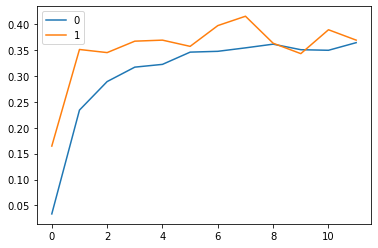

In [220]:
print(model_idx[3])
pd.DataFrame([scores[3]['recall'],scores[3]['val_recall']]).T.plot();

#### find best model based on validation recall: 3

In [221]:
best_nn = models.load_model('saved_nn/model' + '1.1')

In [222]:
pred_probs = best_nn.predict(X_test).flatten()

In [223]:
pred_labels = np.where(pred_probs>0.5,1,0)

In [224]:
utilities.plot_cm(y_test, pred_labels)

In [225]:
print(classification_report(y_test, pred_labels))

              precision    recall  f1-score   support

           0       0.84      0.95      0.89      5841
           1       0.68      0.38      0.49      1659

    accuracy                           0.82      7500
   macro avg       0.76      0.67      0.69      7500
weighted avg       0.81      0.82      0.80      7500



From the confusion matrix and the classification report, it is clear that the model has a good performance overall. However, it is not very good at detecting the defaulting samples.

We now look into the probabilities of default to see if the performance is better.

In [226]:
df_pred, summary_NN = utilities.compute_SSM(pred_probs, pred_labels, true_labels=y_test, name_model='Neural Network', n=50)

In [227]:
summary_NN

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.946
Model:                            OLS   Adj. R-squared:                  0.946
Method:                 Least Squares   F-statistic:                 1.295e+05
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        23:03:29   Log-Likelihood:                 12459.
No. Observations:                7400   AIC:                        -2.491e+04
Df Residuals:                    7398   BIC:                        -2.490e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0440      0.001    -49.265      0.000      -0.046      -0.042
x1             1.1965      0.003    359.823      0.000       1.190       1.203
==============================================================================
Omnibus:                      810.161   Durbin-Watson:                   0.013
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1477.996
Skew:                           0.735   Prob(JB):                         0.00
Kurtosis:                       4.623   Cond. No.                         6.67
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The regression line obtained in this case is very good, and seems to capture very well the true probabilities, as suggeted by the high value of the R-squared. 

In [228]:
utilities.plot_ROC(pred_probs, y_test, model_name='Neural Network')

In [272]:
save_scores(macro_recall=0.67, accuracy=0.82, r2=0.946, auc=0.7707, method_name='Neural Network')

## Neural Network with Oversampling

We implement the same structure with the oversampled data to try to improve the performance on the defaulting class.

In [249]:
scores_res = []
model_idx_res = []

for i, lay in enumerate(layers):
    print(f"\nLayer configuration number {i}: ")
    for j, act in enumerate(activations):
        print("activation: "+act)
        model = create_model(lay, activation=act)
        history = model.fit(X_res, y_res, validation_split=0,epochs=12, verbose=0)#, class_weight=class_weight)
        scores_res.append(history.history)
        model_idx_res.append(dict(layers=lay, activation=act))
        path = 'saved_nn/model_res' + str(i)+'.'+str(j) 
        model.save(path)


Layer configuration number 0: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model_res0.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model_res0.1/assets

Layer configuration number 1: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model_res1.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model_res1.1/assets

Layer configuration number 2: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model_res2.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model_res2.1/assets

Layer configuration number 3: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model_res3.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model_res3.1/assets


In [250]:
model_idx_res

[{'layers': [121, 53, 77], 'activation': 'sigmoid'},
 {'layers': [121, 53, 77], 'activation': 'relu'},
 {'layers': [22, 9, 19, 98], 'activation': 'sigmoid'},
 {'layers': [22, 9, 19, 98], 'activation': 'relu'},
 {'layers': [120, 53, 92, 40], 'activation': 'sigmoid'},
 {'layers': [120, 53, 92, 40], 'activation': 'relu'},
 {'layers': [121, 53, 77, 91], 'activation': 'sigmoid'},
 {'layers': [121, 53, 77, 91], 'activation': 'relu'}]

In [251]:
for s in scores_res:
    precision_key, recall_key = list(s.keys())[2] , list(s.keys())[3]
    if precision_key != 'precision':
        s['precision'] = s[precision_key]  
        del s[precision_key]  
    if recall_key != 'recall':
        s['recall'] = s[recall_key]
        del s[recall_key]

In [252]:
metrics_list, metrics_names, opt_val, model_is = [],[],[],[]

for m in scores_res[0].keys():
    s = []
    for i in range(len(scores_res)):
        last= scores_res[i][m][-1]
        s.append(last)
    if m == 'loss' or m=='val_loss':
        opt = np.min(s)
        idx = s.index(min(s))
        print(f"min {m}: {opt} obtained with model {idx}")
    else: 
        opt = np.max(s)
        idx = s.index(max(s))
        print(f"max {m}: {opt} obtained with model {idx}")
    metrics_list.append(s)
    metrics_names.append(m)
    opt_val.append(opt)
    model_is.append(idx)

min loss: 0.5746212005615234 obtained with model 6
max acc: 0.69725501537323 obtained with model 1
max precision: 0.7820501327514648 obtained with model 2
max recall: 0.605661153793335 obtained with model 6


In [253]:
pd.DataFrame([metrics_names, opt_val, model_is, metrics_list], 
             index=['metric', 'opt_val', 'model_is', 'metrics_list']).T

,metric,opt_val,model_is,metrics_list
0,loss,0.574621,6,"[0.5748502016067505, 0.575673520565033, 0.5981..."
1,acc,0.697255,1,"[0.6911202669143677, 0.69725501537323, 0.68293..."
2,precision,0.78205,2,"[0.738396942615509, 0.7510713934898376, 0.7820..."
3,recall,0.605661,6,"[0.591964840888977, 0.5900816321372986, 0.5072..."


In [254]:
pd.DataFrame([metrics_list[1],metrics_list[-1], metrics_list[-2]], index=['acc','recall','precision']).T

,acc,recall,precision
0,0.691120,0.591965,0.738397
1,0.697255,0.590082,0.751071
2,0.682931,0.507219,0.782050
3,0.685813,0.557153,0.750192
4,0.692033,0.588198,0.742365
5,0.696656,0.585630,0.752788
6,0.693546,0.605661,0.734820
7,0.697227,0.596131,0.747210


Because of oversampling, we cannot look at validation measures because the training data is also repeated into the validation split. Therefore, to pick the best model among those that we built, we look at all measures taken together.

The recall is highest for model 6, and since the accuracy and precision are very close to the highest value, we pick this model as best.

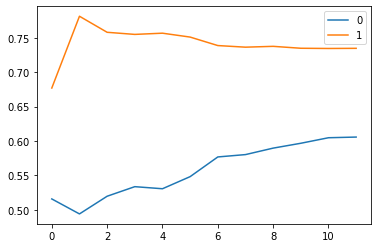

In [255]:
pd.DataFrame([scores_res[6]['recall'],scores_res[6]['precision']]).T.plot();

In [256]:
best_nn_res = models.load_model('saved_nn/model_res' + '3.0')

In [257]:
# Test the model
y_prob = best_nn_res.predict(X_test)
pred_labels = np.where(y_prob > 0.5, 1,0)

pred_probs = best_nn_res.predict(X_test).flatten()

In [258]:
utilities.plot_cm(y_test, pred_labels)

In [259]:
print(classification_report(y_test, pred_labels))

              precision    recall  f1-score   support

           0       0.88      0.81      0.85      5841
           1       0.49      0.63      0.55      1659

    accuracy                           0.77      7500
   macro avg       0.68      0.72      0.70      7500
weighted avg       0.80      0.77      0.78      7500



In this case we have a much better performance on the defaulting class, while the overall accuracy is lower (from 0.82 to 0.77). However, the recall increased (from 0.66 to 0.72). This is driven by the better performance on the defaulting class, where we are able to predict correctly more than 50%, as well as by a poorer performance on the non defaulting class, which is still quite good nonetheless.

In [260]:
df_pred, summary_NN = utilities.compute_SSM(pred_probs, pred_labels, true_labels=y_test, name_model='Neural Network oversampling', n=50)

In [261]:
summary_NN

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.907
Model:                            OLS   Adj. R-squared:                  0.907
Method:                 Least Squares   F-statistic:                 7.243e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        23:26:06   Log-Likelihood:                 10250.
No. Observations:                7400   AIC:                        -2.050e+04
Df Residuals:                    7398   BIC:                        -2.048e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.2104      0.002   -121.083      0.000      -0.214      -0.207
x1             0.9582      0.004    269.120      0.000       0.951       0.965
==============================================================================
Omnibus:                      188.844   Durbin-Watson:                   0.007
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              168.417
Skew:                           0.314   Prob(JB):                     2.68e-37
Kurtosis:                       2.612   Cond. No.                         6.10
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [262]:
utilities.plot_ROC(pred_probs, y_test, model_name='Neural Network Oversampling')

In [273]:
save_scores(macro_recall=0.72, accuracy=0.77, r2=0.907, auc=0.7869, method_name='Neural Network Oversampling')

Since the oversampling improved the performance of the network on the defaulting class without harming the overall performance, we implement the same network structure using feature selection.

## Neural Network with Oversampling and Feature Selection


In [138]:
scores_res = []
model_idx_res = []

for i, lay in enumerate(layers):
    print(f"\nLayer configuration number {i}: ")
    for j, act in enumerate(activations):
        print("activation: "+act)
        model = create_model(lay, activation=act, X_train=X_res_vs)
        history = model.fit(X_res_vs, y_res_vs, validation_split=0,epochs=12, verbose=0)#, class_weight=class_weight)
        scores_res.append(history.history)
        model_idx_res.append(dict(layers=lay, activation=act))
        path = 'saved_nn/model_res_vs' + str(i)+'.'+str(j) 
        model.save(path)


Layer configuration number 0: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model_res0.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model_res0.1/assets

Layer configuration number 1: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model_res1.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model_res1.1/assets

Layer configuration number 2: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model_res2.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model_res2.1/assets

Layer configuration number 3: 
activation: sigmoid
INFO:tensorflow:Assets written to: saved_nn/model_res3.0/assets
activation: relu
INFO:tensorflow:Assets written to: saved_nn/model_res3.1/assets


In [139]:
for s in scores_res:
    precision_key, recall_key = list(s.keys())[2] , list(s.keys())[3]
    if precision_key != 'precision':
        s['precision'] = s[precision_key]  
        del s[precision_key]  
    if recall_key != 'recall':
        s['recall'] = s[recall_key]
        del s[recall_key]

In [140]:
metrics_list, metrics_names, opt_val, model_is = [],[],[],[]

for m in scores_res[0].keys():
    s = []
    for i in range(len(scores_res)):
        last= scores_res[i][m][-1]
        s.append(last)
    if m == 'loss' or m=='val_loss':
        opt = np.min(s)
        idx = s.index(min(s))
        print(f"min {m}: {opt} obtained with model {idx}")
    else: 
        opt = np.max(s)
        idx = s.index(max(s))
        print(f"max {m}: {opt} obtained with model {idx}")
    metrics_list.append(s)
    metrics_names.append(m)
    opt_val.append(opt)
    model_is.append(idx)

min loss: 0.6074876189231873 obtained with model 6
max acc: 0.6706899404525757 obtained with model 6
max precision: 0.7650288343429565 obtained with model 2
max recall: 0.49900132417678833 obtained with model 1


In [141]:
pd.DataFrame([metrics_names, opt_val, model_is, metrics_list], 
             index=['metric', 'opt_val', 'model_is', 'metrics_list']).T

,metric,opt_val,model_is,metrics_list
0,loss,0.607488,6,"[0.6076174974441528, 0.6097384691238403, 0.619..."
1,acc,0.67069,6,"[0.6706613898277283, 0.6704331636428833, 0.665..."
2,precision,0.765029,2,"[0.7633177638053894, 0.7593573331832886, 0.765..."
3,recall,0.499001,1,"[0.4947212338447571, 0.49900132417678833, 0.47..."


In [142]:
pd.DataFrame([metrics_list[1],metrics_list[-1], metrics_list[-2]], index=['acc','recall','precision']).T

,acc,recall,precision
0,0.670661,0.494721,0.763318
1,0.670433,0.499001,0.759357
2,0.665297,0.477144,0.765029
3,0.665868,0.487987,0.757463
4,0.670661,0.496205,0.762118
5,0.668750,0.494949,0.758660
6,0.670690,0.495977,0.762368
7,0.667979,0.496604,0.755579


The recall is highest for model 1, and since the accuracy and precision are very close to the highest value, we pick this model as best.

In [143]:
best_nn_res_vs = models.load_model('saved_nn/model_res_vs' + '0.1')

In [144]:
# Test the model
y_prob = best_nn_res_vs.predict(X_test_vs)
pred_labels = np.where(y_prob > 0.5, 1,0)

pred_probs = best_nn_res_vs.predict(X_test_vs).flatten()

In [145]:
utilities.plot_cm(y_test_vs, pred_labels)

In [146]:
print(classification_report(y_test_vs, pred_labels))

              precision    recall  f1-score   support

           0       0.87      0.85      0.86      5841
           1       0.51      0.54      0.53      1659

    accuracy                           0.78      7500
   macro avg       0.69      0.70      0.69      7500
weighted avg       0.79      0.78      0.79      7500



The overall accuraccy hasn't changed compared to the model without variable selection. However, the performance on the defaulting class has decreased (from 0.72 to 0.70), thus leading to worse results for what we are interested in.

In [147]:
df_pred, summary_NN = utilities.compute_SSM(pred_probs, pred_labels, true_labels=y_test_vs, name_model='Neural Network oversampling VS', n=50)

In [148]:
summary_NN

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.927
Model:                            OLS   Adj. R-squared:                  0.927
Method:                 Least Squares   F-statistic:                 9.450e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:19:43   Log-Likelihood:                 12101.
No. Observations:                7400   AIC:                        -2.420e+04
Df Residuals:                    7398   BIC:                        -2.418e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.2262      0.002   -146.641      0.000      -0.229      -0.223
x1             0.9724      0.003    307.413      0.000       0.966       0.979
==============================================================================
Omnibus:                      118.996   Durbin-Watson:                   0.025
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              124.411
Skew:                           0.316   Prob(JB):                     9.65e-28
Kurtosis:                       3.072   Cond. No.                         7.00
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [149]:
utilities.plot_ROC(pred_probs, y_test_vs, model_name='Neural Network Oversampling VS')

In summary, we can say that we get very similar results using only the 5 most important variables.

In [274]:
save_scores(macro_recall=0.70, accuracy=0.78, r2=0.927, auc=0.751, method_name='Neural Network Oversampling with variable selection')

## Gaussian Naive Bayes Classifier

We do not have priors for the distributions. We don't pass the actual proportions of defaulting and non-defaulting clients in the data to avoid overfitting.

In [151]:
from sklearn.naive_bayes import GaussianNB

gnb = GaussianNB()#priors = (0.9450000000000005, 0.054999999999999494))#list(class_weight.values()))
y_pred_nb = gnb.fit(X_train, y_train).predict(X_test)
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test.shape[0], (y_test != y_pred_nb).sum()))

Number of mislabeled points out of a total 7500 points : 2281


In [152]:
utilities.plot_cm(y_test, y_pred_nb)

In [153]:
print(classification_report(y_test, y_pred_nb))

              precision    recall  f1-score   support

           0       0.89      0.69      0.78      5841
           1       0.40      0.71      0.51      1659

    accuracy                           0.70      7500
   macro avg       0.65      0.70      0.64      7500
weighted avg       0.78      0.70      0.72      7500



In [154]:
pred_probs = gnb.fit(X_train, y_train).predict_proba(X_test)

In [155]:
df_pred, summary_gnb = utilities.compute_SSM(pred_probs, y_pred_nb, true_labels=y_test, name_model='Gaussian Naive Bayes', n=50)

In [156]:
summary_gnb

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.731
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                 2.012e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:19:47   Log-Likelihood:                 6959.8
No. Observations:                7400   AIC:                        -1.392e+04
Df Residuals:                    7398   BIC:                        -1.390e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0008      0.002     -0.430      0.667      -0.005       0.003
x1             0.4712      0.003    141.844      0.000       0.465       0.478
==============================================================================
Omnibus:                      319.395   Durbin-Watson:                   0.003
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              340.713
Skew:                           0.503   Prob(JB):                     1.04e-74
Kurtosis:                       2.696   Cond. No.                         3.73
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [157]:
utilities.plot_ROC(pred_probs, y_test, model_name='Gaussian Naive Bayes')

We can infer that the Gaussian Naive Bayes Classifier has quite a good performance in the prediction of the labels, which translates into a quite good confusion matrix and good values for recall and accuracy (both 0.7). On the other hand, the predictions of the probabilities of default leads to unsatisfactory results, with an R-squared of only 73% and a line with slope equal to 0.5 (which ideally we would want to be at 1). 

In [275]:
save_scores(macro_recall=0.70, accuracy=0.70, r2=0.731, auc=0.7518, method_name='Gaussian Naive Bayes')

## Naive Bayes Classifier with Variable Selection


In [159]:
gnb = GaussianNB()
y_pred_nb = gnb.fit(X_train_vs, y_train_vs).predict(X_test_vs)
print("Number of mislabeled points out of a total %d points : %d"
      % (X_test_vs.shape[0], (y_test_vs != y_pred_nb).sum()))

Number of mislabeled points out of a total 7500 points : 1468


In [160]:
utilities.plot_cm(y_test_vs, y_pred_nb)

In [161]:
print(classification_report(y_test_vs, y_pred_nb))

              precision    recall  f1-score   support

           0       0.82      0.96      0.88      5841
           1       0.66      0.24      0.35      1659

    accuracy                           0.80      7500
   macro avg       0.74      0.60      0.62      7500
weighted avg       0.78      0.80      0.77      7500



In this case, it is clear that the overall performance of the model has increased both in terms of accuracy (from 0.70 to 0.80) and considering the probabilities of default (R-squared of regression increased from 0.731 to 0.823). 

On the other hand, if we evaluate the model looking at the defaulting class (from the confusion matrix) and at the macro-recall (from 0.7 to 0.6), the performance has dropped substantially.

In [162]:
pred_probs = gnb.fit(X_train_vs, y_train_vs).predict_proba(X_test_vs)

In [163]:
df_pred, summary_gnb = utilities.compute_SSM(pred_probs, y_pred_nb, true_labels=y_test_vs, name_model='Gaussian Naive Bayes VS', n=50)

In [164]:
summary_gnb

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.823
Model:                            OLS   Adj. R-squared:                  0.823
Method:                 Least Squares   F-statistic:                 3.430e+04
Date:                Fri, 09 Dec 2022   Prob (F-statistic):               0.00
Time:                        22:19:51   Log-Likelihood:                 9246.8
No. Observations:                7400   AIC:                        -1.849e+04
Df Residuals:                    7398   BIC:                        -1.848e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0267      0.001     20.487      0.000       0.024       0.029
x1             0.8655      0.005    185.211      0.000       0.856       0.875
==============================================================================
Omnibus:                      741.049   Durbin-Watson:                   0.013
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              981.582
Skew:                           0.852   Prob(JB):                    7.12e-214
Kurtosis:                       3.529   Cond. No.                         6.08
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [165]:
utilities.plot_ROC(pred_probs, y_test, model_name='Gaussian Naive Bayes VS')

In this case, feature selction leads to better predictive power when it comes to predicting probabilities of default using the Sorting Smoothing Method, whereas the recall on the defaulting class is quite low.

In [276]:
save_scores(macro_recall=0.60, accuracy=0.80, r2=0.823, auc=0.7125, method_name='Gaussian Naive Bayes with variable selection')

# FINAL SUMMARY OF METHODS PERFORMANCES

We display below a summary of the scores obtained by the different models. 
We see that models can be classified differently based on the metric of evaluation chosen. 


In [277]:
pd.DataFrame([method_names, macro_recalls, accuracies, r2s, aucs], 
             index=['method', 'macro_recall', 'accuracy', 'R-squared', 'AUC']).T

,method,macro_recall,accuracy,R-squared,AUC
0,QDA,0.71,0.78,0.859,0.7546
1,QDA with variable selection,0.59,0.8,0.812,0.7079
2,KNN,0.7,0.74,0.848,0.7579
3,KNN with variable selection,0.66,0.72,0.676,0.6788
4,Logistic Regression,0.68,0.69,0.684,0.7391
5,Logistic Regression with variable selection,0.64,0.63,0.551,0.7009
6,Bagging,0.65,0.81,0.931,0.7559
7,Bagging with variable selection,0.63,0.81,0.944,0.7542
8,Neural Network,0.67,0.82,0.946,0.7707
9,Neural Network Oversampling,0.72,0.77,0.907,0.7869


Looking at R-squared, we see that the best performing metohds are neural networks and bagging of decision tree classifiers. 
Concerning macro-recall instead, the highest scoures are obtained by neural networks and QDA, followed closely by other methods. 

#### Comment on Variable Selection
As outlined by the paper by Yeh, I.-C., Lien, C.-H. (2016), we also found that building models using the most important features only can lead to fairly good results. However, in this specific case we believe that variable selection isn't necessary due to the small dimension of the data at hand. With higher dimensionality it wwould for sure reduct computational costs significantly, but in this case we believe that the computational effort spared isn't worth the loss of information and performance in the classification.


# ERROR ANALYSIS  
We now perform some exploratory analysis on the predictions of the two best performing methods in terms of default probability prediction: Bagging and Neural Networks. 

### Bagging Predictions

In [168]:
inversed = ss.inverse_transform(X_test)
#print(inversed)

In [169]:
data.columns

Index(['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2',
       'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default payment next month', 'PUNCTUALITY_AVG'],
      dtype='object', name=0)

In [170]:
X_test_df = pd.DataFrame(inversed, columns=list(data.columns)[:-2])
print(len(X_test_df))
X_test_df

7500


,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
0,200000.0,2.0,3.0,2.0,28.0,1.0,-2.0,-2.0,-1.000000e+00,-1.0,...,0.0,304.0,13489.0,6788.0,0.0,0.0,304.0,13489.0,6788.0,188.0
1,150000.0,2.0,1.0,1.0,36.0,-2.0,-2.0,-2.0,-2.000000e+00,-2.0,...,4975.0,3960.0,2914.0,1068.0,30745.0,4975.0,5017.0,2914.0,1250.0,4734.0
2,240000.0,2.0,2.0,1.0,39.0,0.0,0.0,0.0,2.775558e-17,0.0,...,243554.0,211924.0,216395.0,231767.0,8900.0,9500.0,8000.0,8000.0,19000.0,10000.0
3,260000.0,1.0,1.0,2.0,36.0,0.0,0.0,0.0,2.775558e-17,0.0,...,59934.0,61680.0,65403.0,66745.0,5195.0,2961.0,3000.0,5000.0,2700.0,2800.0
4,80000.0,1.0,1.0,2.0,27.0,-1.0,-1.0,-1.0,-1.000000e+00,-1.0,...,600.0,100.0,900.0,2934.0,600.0,600.0,100.0,900.0,2934.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7495,100000.0,1.0,2.0,1.0,24.0,1.0,2.0,2.0,2.000000e+00,2.0,...,13609.0,14683.0,15001.0,15306.0,700.0,700.0,1300.0,700.0,700.0,0.0
7496,30000.0,1.0,3.0,2.0,58.0,-1.0,-1.0,-1.0,2.775558e-17,0.0,...,1170.0,780.0,780.0,0.0,390.0,1170.0,0.0,0.0,0.0,0.0
7497,50000.0,1.0,3.0,2.0,32.0,0.0,0.0,0.0,2.775558e-17,0.0,...,48516.0,19078.0,19220.0,19514.0,2189.0,1600.0,1600.0,700.0,700.0,857.0
7498,180000.0,1.0,1.0,1.0,39.0,0.0,0.0,0.0,-1.000000e+00,0.0,...,281713.0,242063.0,122295.0,-1005.0,20000.0,11000.0,145000.0,26000.0,0.0,101005.0


In [171]:
y_pred= bagging.predict(X_test)

In [172]:
X_test_df['y_true'] = np.array(y_test)
X_test_df['y_pred'] = y_pred

In [173]:
mistakes= X_test_df[X_test_df['y_true']!= X_test_df['y_pred']]
print(len(mistakes))

1406


In [174]:
false_pos=mistakes[mistakes['y_true']==0]
false_neg=mistakes[mistakes['y_true']==1]

## Falsely predicted as Defaulting (False Positives)

In [175]:
fig = px.histogram(false_pos, x="LIMIT_BAL",width=600, height=300)
fig.show()

In [176]:
fig = px.histogram(false_pos, x="SEX", nbins=2,width=600, height=300)
fig.update_layout(bargap=0.2)
fig.show()

In [177]:
fig = px.histogram(false_pos, x="EDUCATION", width=600, height=300)
fig.update_layout(bargap=0.05)
fig.show()

In [178]:
fig = px.histogram(false_pos, x="MARRIAGE", width=600, height=300)
fig.update_layout(bargap=0.05)
fig.show()

## Not detected Defaulting (False Negatives)

In [179]:
fig = px.histogram(false_neg, x="LIMIT_BAL",width=600, height=300)
fig.show()

In [180]:
fig = px.histogram(false_neg, x="SEX", nbins=2,width=600, height=300)
fig.update_layout(bargap=0.2)
fig.show()

In [181]:
fig = px.histogram(false_neg, x="EDUCATION", width=600, height=300)
fig.update_layout(bargap=0.05)
fig.show()

In [182]:
fig = px.histogram(false_neg, x="MARRIAGE", width=600, height=300)
fig.update_layout(bargap=0.05)
fig.show()

# ERROR ANALYSIS with Neural Network Predictions

In [183]:
inversed = ss.inverse_transform(X_test)
#print(inversed)

In [244]:
X_test_df = pd.DataFrame(inversed, columns=list(data.columns)[:-2])
print(len(X_test_df))
X_test_df

7500


,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
0,200000.0,2.0,3.0,2.0,28.0,1.0,-2.0,-2.0,-1.000000e+00,-1.0,...,0.0,304.0,13489.0,6788.0,0.0,0.0,304.0,13489.0,6788.0,188.0
1,150000.0,2.0,1.0,1.0,36.0,-2.0,-2.0,-2.0,-2.000000e+00,-2.0,...,4975.0,3960.0,2914.0,1068.0,30745.0,4975.0,5017.0,2914.0,1250.0,4734.0
2,240000.0,2.0,2.0,1.0,39.0,0.0,0.0,0.0,2.775558e-17,0.0,...,243554.0,211924.0,216395.0,231767.0,8900.0,9500.0,8000.0,8000.0,19000.0,10000.0
3,260000.0,1.0,1.0,2.0,36.0,0.0,0.0,0.0,2.775558e-17,0.0,...,59934.0,61680.0,65403.0,66745.0,5195.0,2961.0,3000.0,5000.0,2700.0,2800.0
4,80000.0,1.0,1.0,2.0,27.0,-1.0,-1.0,-1.0,-1.000000e+00,-1.0,...,600.0,100.0,900.0,2934.0,600.0,600.0,100.0,900.0,2934.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7495,100000.0,1.0,2.0,1.0,24.0,1.0,2.0,2.0,2.000000e+00,2.0,...,13609.0,14683.0,15001.0,15306.0,700.0,700.0,1300.0,700.0,700.0,0.0
7496,30000.0,1.0,3.0,2.0,58.0,-1.0,-1.0,-1.0,2.775558e-17,0.0,...,1170.0,780.0,780.0,0.0,390.0,1170.0,0.0,0.0,0.0,0.0
7497,50000.0,1.0,3.0,2.0,32.0,0.0,0.0,0.0,2.775558e-17,0.0,...,48516.0,19078.0,19220.0,19514.0,2189.0,1600.0,1600.0,700.0,700.0,857.0
7498,180000.0,1.0,1.0,1.0,39.0,0.0,0.0,0.0,-1.000000e+00,0.0,...,281713.0,242063.0,122295.0,-1005.0,20000.0,11000.0,145000.0,26000.0,0.0,101005.0


In [278]:
y_prob = best_nn_res.predict(X_test)
y_pred = np.where(y_prob > 0.5, 1,0)

In [279]:
X_test_df['y_true'] = np.array(y_test)
X_test_df['y_pred'] = y_pred

In [280]:
X_test_df

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,y_true,y_pred
0,200000.0,2.0,3.0,2.0,28.0,1.0,-2.0,-2.0,-1.000000e+00,-1.0,...,13489.0,6788.0,0.0,0.0,304.0,13489.0,6788.0,188.0,0,0
1,150000.0,2.0,1.0,1.0,36.0,-2.0,-2.0,-2.0,-2.000000e+00,-2.0,...,2914.0,1068.0,30745.0,4975.0,5017.0,2914.0,1250.0,4734.0,0,0
2,240000.0,2.0,2.0,1.0,39.0,0.0,0.0,0.0,2.775558e-17,0.0,...,216395.0,231767.0,8900.0,9500.0,8000.0,8000.0,19000.0,10000.0,0,0
3,260000.0,1.0,1.0,2.0,36.0,0.0,0.0,0.0,2.775558e-17,0.0,...,65403.0,66745.0,5195.0,2961.0,3000.0,5000.0,2700.0,2800.0,0,0
4,80000.0,1.0,1.0,2.0,27.0,-1.0,-1.0,-1.0,-1.000000e+00,-1.0,...,900.0,2934.0,600.0,600.0,100.0,900.0,2934.0,0.0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7495,100000.0,1.0,2.0,1.0,24.0,1.0,2.0,2.0,2.000000e+00,2.0,...,15001.0,15306.0,700.0,700.0,1300.0,700.0,700.0,0.0,1,1
7496,30000.0,1.0,3.0,2.0,58.0,-1.0,-1.0,-1.0,2.775558e-17,0.0,...,780.0,0.0,390.0,1170.0,0.0,0.0,0.0,0.0,0,1
7497,50000.0,1.0,3.0,2.0,32.0,0.0,0.0,0.0,2.775558e-17,0.0,...,19220.0,19514.0,2189.0,1600.0,1600.0,700.0,700.0,857.0,1,0
7498,180000.0,1.0,1.0,1.0,39.0,0.0,0.0,0.0,-1.000000e+00,0.0,...,122295.0,-1005.0,20000.0,11000.0,145000.0,26000.0,0.0,101005.0,0,0


In [281]:
mistakes= X_test_df[X_test_df['y_true']!= X_test_df['y_pred']]
print(len(mistakes))

1721


In [282]:
false_pos=mistakes[mistakes['y_true']==0]
false_neg=mistakes[mistakes['y_true']==1]

## Falsely predicted as Defaulting (False Positives)

In [283]:
fig = px.histogram(false_pos, x="LIMIT_BAL",width=600, height=300)
fig.show()

In [284]:
fig = px.histogram(false_pos, x="SEX", nbins=2,width=600, height=300)
fig.update_layout(bargap=0.2)
fig.show()

In [285]:
fig = px.histogram(false_pos, x="EDUCATION", width=600, height=300)
fig.update_layout(bargap=0.05)
fig.show()

In [286]:
fig = px.histogram(false_pos, x="MARRIAGE", width=600, height=300)
fig.update_layout(bargap=0.05)
fig.show()

## Not detected Defaulting (False Negatives)

In [287]:
fig = px.histogram(false_neg, x="LIMIT_BAL",width=600, height=300)
fig.show()

In [288]:
fig = px.histogram(false_neg, x="SEX", nbins=2,width=600, height=300)
fig.update_layout(bargap=0.2)
fig.show()

In [289]:
fig = px.histogram(false_neg, x="EDUCATION", width=600, height=300)
fig.update_layout(bargap=0.05)
fig.show()

In [290]:
fig = px.histogram(false_neg, x="MARRIAGE", width=600, height=300)
fig.update_layout(bargap=0.05)
fig.show()

# Conclusion

The error analysis didn't yield interesting insights about bias in default prediction after the concession of credit. A very important limitation that must be pointed out is the fact that we do not have data about those individuals who have been excluded from credit, where we might be able to find bias. 

An important conclusion from this work is that several models can be adequate for the same task, and might help institutions in different ways. As a matter of fact, the choice of the metrics of evaluation of a model is a choice that impacts all the subsequent decisions, and should be made with an economic rationale in mind. 
In fact, looking only at the macro-recall wouldn't allow us to understand by how much each sample has been correctly classified or misclassified, whereas the Sorting Smoothing Method doesn't give a final decision, and another rule needs to be applied according to some threshold.

Other possible startegies therefore must include the exploration of other metrics of evaluation in order to measure different characteristics of each method.